# Set-up

In [54]:
# Import Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from numpy import loadtxt
import os, glob
import geopandas as gpd
import geojsonio
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
import math
from IPython.display import Image
from currency_converter import CurrencyConverter
from datetime import date

# Plotly
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import cufflinks as cf

import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.subplots import make_subplots
init_notebook_mode(connected=True)
cf.go_offline()
%matplotlib inline
#pd.options.plotting.backend = "plotly"

In [51]:
# Dashboard (Global Variables)
dataset_loc = "berlin"  # "berlin", "paris", "amsterdam"
dataset_date = "2020-03-17"  # "2019-12-11", "2020-01-10", "2020-02-18", "2020-03-17", "2020-05-14"
target = "price_log"
figcount = 0
figpath = f"figures_engineered/{dataset_loc}_{dataset_date}/"
curr = CurrencyConverter()

# Table Display Settings
pd.set_option('display.max_columns', 150)
pd.set_option('display.max_rows', 100)
pd.options.display.max_seq_items = 300
pd.set_option('display.max_colwidth', 150)

#Plotting Settings
sns.set(style="white")  #, palette=["#FF5A5F", "#00A699"])
sns.set_palette(
    sns.color_palette(
        ["#767676", "#00A699", "#FF5A5F", "#F9C70C", "#FC642D", "#484848"]))

pio.templates.default = "simple_white"
px.defaults.template = "simple_white"  # 'ggplot2', 'seaborn', 'simple_white', 'plotly', 'plotly_white', 'plotly_dark', 'presentation', 'xgridoff', 'ygridoff', 'gridon', 'none'
px.defaults.color_continuous_scale = [
    "#00A699", "#50D6B9", "#FF9A7F", "#FF5A5F"
]  # ["#50D6B9", "#00A699", "#FF9A7F", "#FF5A5F"] #"burgyl"
px.defaults.color_discrete_sequence = [
    "#767676", "#00A699", "#FF5A5F", "#F9C70C", "#FC642D", "#484848"
]
px.defaults.width = 900
px.defaults.height = 600

In [3]:
# Import data_engineered
data = pd.read_pickle(f"saves/{dataset_loc}_{dataset_date}/data_engineered.pkl")

In [4]:
# Create path to save figures (if not existing)
if not os.path.exists(figpath):
    os.mkdir(figpath)

In [5]:
# Delete all saved plots (caution!)
del_files = glob.glob(f'{figpath}*')
for f in del_files:
    os.remove(f)

In [6]:
# Function for saving plots with continuous number
def savefig(fig=None, title="Untitled", library="py"):
    global figcount
    global figpath
    existing = False
    filesave = ""
    save_files = glob.glob(f'{figpath}*')
    for f in save_files:
        if title in f:
            existing = True
            filesave = f
    if existing == True:
        if library == "py":
            fig.write_image(filesave)
        elif library == "plt":
            plt.savefig(filesave)
        else:
            print("Please enter valid library ('py', 'plt')")
    else:
        figcount += 1
        if library == "py":
            fig.write_image(f"{figpath}fig{figcount:02d}_{title}.png")
        elif library == "plt":
            plt.savefig(f"{figpath}fig{figcount:02d}_{title}.png")
        else:
            print("Please enter valid library ('py', 'plt')")
            figcount -= 1

# Data Exploration

In [7]:
# Display available columns from "data"
data.columns

Index(['accommodates', 'accommodates_per_bed', 'am_balcony', 'am_breakfast',
       'am_child_friendly', 'am_elevator', 'am_essentials',
       'am_nature_and_views', 'am_pets_allowed', 'am_private_entrance',
       'am_smoking_allowed', 'am_tv', 'am_white_goods', 'availability_90',
       'bathrooms_log', 'bedrooms', 'calc_host_lst_count_sqrt_log',
       'cancellation_policy', 'first_review_days_sqrt', 'guests_included_calc',
       'host_acceptance_rate', 'host_is_superhost', 'host_response_rate',
       'host_response_time', 'instant_bookable', 'last_review_days_sqrt',
       'latitude', 'listing_no', 'longitude', 'maximum_nights',
       'minimum_nights_sqrt', 'neighbourhood_cleansed',
       'number_of_reviews_ltm_log', 'occupancy_class', 'occupancy_rate',
       'price', 'price_calc_log', 'price_class', 'price_extra_fees_sqrt',
       'price_extra_people', 'price_log', 'property_type',
       'review_scores_calc', 'review_scores_class', 'review_scores_class_new',
       'review_

In [8]:
# Define "reduced_features"
reduced_features = [
    "accommodates",
    "availability_365",
    #                   "availability_90",
    #                   "bathrooms",
    #                   "bedrooms",
    #                   "beds",
    "calculated_host_listings_count",
    "extra_people",
    #                   "guests_included",
    #                   "maximum_nights",
    "minimum_nights",
    "price",
    "review_scores_rating"
]

In [9]:
# Separate/create variables for numerical and categorical features
num_features = list(data.columns[data.dtypes != object])
cat_features = list(data.columns[data.dtypes == object])
#data_cont = data[num_features]

## Interactive Dashboards

In [10]:
# Display figures from graphical exploration below direcly here in the dashboard
@interact_manual
def show_images(file=sorted(os.listdir(figpath))):
    display(Image(figpath + file))

interactive(children=(Dropdown(description='file', options=(), value=None), Button(description='Run Interact',…

In [11]:
# Display table with all rows where feature value is > x (where x is the selected threshold)
@interact(x=widgets.IntSlider(1, 0, 100, 1, continuous_update=False))
def filter_data(column=num_features, x=10):
    return data.loc[data[column] > x]

interactive(children=(Dropdown(description='column', options=('accommodates', 'accommodates_per_bed', 'am_balc…

In [12]:
# Display interactive plot for comparing two features
@interact_manual(
    x=widgets.Dropdown(options=list(data.select_dtypes('number').columns),
                       index=0,
                       description="Feature"),
    y=widgets.Dropdown(options=list(data.select_dtypes('number').columns),
                       value=target,
                       description="Target"),
    kind=widgets.Dropdown(
        options=["bar", "box", "bubble", "heatmap", "histogram", "scatter"],
        value="bar",
        description="Plot Type"))
#                 text='title',
#                 theme=widgets.Dropdown(options=list(cf.themes.THEMES.keys()),description="Theme"),
#                 colorscale=widgets.Dropdown(options=list(cf.colors._scales_names.keys()),description="Colorscale"))
def scatter_plot(x, y, kind):  #,theme,colorscale):

    data.iplot(kind=kind,
               x=x,
               y=y,
               mode='markers',
               xTitle=str(x),
               yTitle=str(y),
               title=f'{str(y)} vs {str(x)}')


#        text=title,
#        theme=theme,
#        colorscale=colorscale)

interactive(children=(Dropdown(description='Feature', options=('accommodates', 'accommodates_per_bed', 'am_bal…

## Tables (non-graphical exploration)

In [13]:
#profile = ProfileReport(data, title='Pandas Profiling Report', explorative=True)
#profile.to_widgets()
#profile.to_notebook_iframe()

In [14]:
# Examine shape and head/columns of data
print(data.shape)
data.head(1)

(10449, 51)


,accommodates,accommodates_per_bed,am_balcony,am_breakfast,am_child_friendly,am_elevator,am_essentials,am_nature_and_views,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,availability_90,bathrooms_log,bedrooms,calc_host_lst_count_sqrt_log,cancellation_policy,first_review_days_sqrt,guests_included_calc,host_acceptance_rate,host_is_superhost,host_response_rate,host_response_time,instant_bookable,last_review_days_sqrt,latitude,listing_no,longitude,maximum_nights,minimum_nights_sqrt,neighbourhood_cleansed,number_of_reviews_ltm_log,occupancy_class,occupancy_rate,price,price_calc_log,price_class,price_extra_fees_sqrt,price_extra_people,price_log,property_type,review_scores_calc,review_scores_class,review_scores_class_new,review_scores_location,review_scores_rating_sqrt,room_type,text_len_sqrt,wk_mth_discount,zipcode
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
3176,4,2.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0,0.0,1.0,0.0,strict,62.633857,2,80.0,0,100.0,within a few hours,0,16.248077,52.535,3176,13.41758,1125,7.874008,Prenzlauer Berg Südwest,1.0,0,0.0,90.0,4.382027,7,20.0,16.666667,4.49981,Apartment,88.702175,2,1,10.0,6.298521,Entire home/apt,0.771052,0.23545,zip_10405


**Outliers**

In [15]:
# Examine illogical column values (e.g. "accommodates" < "guests_included", "bedrooms" > "beds", ...)
#data[data.accommodates-data.beds < 0]

**Skew**

In [16]:
# Look at data skew (to check whether scaling with e.g. log makes sense for highly skewed features)
data.skew()

accommodates                    1.546642
accommodates_per_bed            2.125756
am_balcony                      1.024416
am_breakfast                    4.164870
am_child_friendly               0.882321
am_elevator                     1.182974
am_essentials                  -4.657509
am_nature_and_views             4.833850
am_pets_allowed                 1.719299
am_private_entrance             1.330516
am_smoking_allowed              2.092436
am_tv                          -0.093714
am_white_goods                 -1.698394
availability_90                 0.234756
bathrooms_log                   2.597438
bedrooms                        2.193853
calc_host_lst_count_sqrt_log    1.975336
first_review_days_sqrt          0.384453
guests_included_calc            2.088661
host_acceptance_rate           -1.282108
host_is_superhost               0.882321
host_response_rate             -3.839442
instant_bookable                0.396361
last_review_days_sqrt           0.841642
latitude        

**Correlation**

In [17]:
# Interactive feature vs. feature correlation check
@interact
def correlations(column1=list(data.select_dtypes('number').columns),
                 column2=list(data.select_dtypes('number').columns)):
    print(f"Correlation: {data[column1].corr(data[column2])}")

interactive(children=(Dropdown(description='column1', options=('accommodates', 'accommodates_per_bed', 'am_bal…

In [18]:
# Full list of correlation values
data.corr()

,accommodates,accommodates_per_bed,am_balcony,am_breakfast,am_child_friendly,am_elevator,am_essentials,am_nature_and_views,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,availability_90,bathrooms_log,bedrooms,calc_host_lst_count_sqrt_log,first_review_days_sqrt,guests_included_calc,host_acceptance_rate,host_is_superhost,host_response_rate,instant_bookable,last_review_days_sqrt,latitude,listing_no,longitude,maximum_nights,minimum_nights_sqrt,number_of_reviews_ltm_log,occupancy_class,occupancy_rate,price,price_calc_log,price_class,price_extra_fees_sqrt,price_extra_people,price_log,review_scores_calc,review_scores_class,review_scores_class_new,review_scores_location,review_scores_rating_sqrt,text_len_sqrt,wk_mth_discount
accommodates,1.000000,0.197002,0.069662,-0.020836,0.317453,0.058653,-0.042621,0.001712,0.079832,0.156877,-0.103182,0.270442,0.038989,0.102001,0.245295,0.667732,0.286895,0.081278,0.619597,0.095810,-0.015121,0.064435,0.096666,-0.050002,0.036156,-0.074857,0.009269,0.120203,-0.061524,0.132304,0.084744,0.094657,0.576815,0.484246,0.500050,0.210392,0.324041,0.556867,-0.080878,-0.136482,-0.116622,-0.065473,-0.122684,0.167788,-0.002930
accommodates_per_bed,0.197002,1.000000,0.036281,0.009757,0.046254,0.062079,-0.067887,-0.006626,0.027188,0.006573,0.010565,0.037804,0.050066,-0.031386,-0.019620,-0.073207,-0.005701,0.007168,0.049400,0.024763,0.002054,-0.003343,0.028568,-0.036651,0.009478,-0.002524,0.030429,0.032653,-0.041243,0.030814,0.005820,0.016523,0.092534,0.136593,0.129973,0.026572,0.166381,0.141502,0.017627,-0.002769,0.011086,0.009688,0.000772,0.033648,-0.004751
am_balcony,0.069662,0.036281,1.000000,-0.013037,0.098804,0.156452,0.072329,0.102340,0.009687,0.038108,0.014330,0.105048,0.145257,-0.035847,0.095456,0.098101,-0.102709,0.048920,0.063311,0.040474,0.120428,0.062340,-0.014995,-0.011422,0.012058,-0.046770,0.006226,-0.021777,0.004075,0.023566,-0.004913,-0.009554,0.133479,0.134459,0.139267,0.113626,0.065592,0.145054,0.118599,0.098568,0.126709,0.051029,0.099131,0.126525,0.024399
am_breakfast,-0.020836,0.009757,-0.013037,1.000000,-0.027619,0.005731,0.031141,0.003314,0.036550,0.000119,0.035359,-0.027929,-0.003670,0.008216,-0.010941,-0.017555,-0.047301,-0.081578,-0.023250,-0.027901,-0.024720,-0.006957,0.023032,0.034563,-0.005566,0.077604,-0.014181,-0.010076,-0.045704,-0.080474,-0.062888,-0.069531,0.019605,0.018026,0.014312,-0.038764,0.008695,0.010801,0.010888,0.057323,0.037557,0.010876,0.050026,-0.014472,-0.032206
am_child_friendly,0.317453,0.046254,0.098804,-0.027619,1.000000,0.032612,-0.011195,0.013799,0.068719,0.019031,-0.082230,0.169674,0.035458,0.057026,0.091948,0.263024,0.113919,0.454482,0.174831,0.005557,0.063919,0.031707,0.008886,0.021668,0.004623,-0.467879,0.017962,0.024053,0.031389,0.141862,0.035356,0.043299,0.220629,0.207348,0.211969,0.158180,0.175099,0.236494,-0.025108,-0.110097,-0.089937,-0.011637,-0.103496,0.194307,0.172192
am_elevator,0.058653,0.062079,0.156452,0.005731,0.032612,1.000000,-0.014558,0.035529,-0.019661,0.000422,-0.017025,0.149368,0.060920,0.050999,0.105809,0.030479,0.112158,0.007565,0.059451,0.016604,0.034070,0.025151,0.016224,0.025173,0.045919,-0.007733,-0.042990,0.032370,0.039362,0.016213,0.004725,0.012697,0.202061,0.206961,0.206754,0.078847,0.029606,0.203243,-0.010208,-0.008408,-0.006911,0.045195,-0.007933,0.027559,-0.008739
am_essentials,-0.042621,-0.067887,0.072329,0.031141,-0.011195,-0.014558,1.000000,0.020574,0.017667,0.056608,0.016505,-0.018528,0.047359,-0.012997,-0.014655,0.000109,-0.150078,-0.071517,0.013133,0.059892,0.095891,0.022282,0.025508,-0.048664,-0.006328,0.080926,0.009736,0.011291,-0.030876,0.061921,0.040129,0.048655,0.010064,0.016199,0.011328,0.026880,-0.035695,0.008400,0.081976,0.081507,0.101981,0.060946,0.074620,0.037848,-0.060534
am_nature_and_views,0.001712,-0.006626,0.102340,0.003314,0.013799,0.035529,0.020574,1.000000,0.027577,0.049823,-0.005818,0.040302,0.005284,0.025722,0.020086,0.006184,-0.013032,-0.007519,0.002603,0.008502,0.042249,0.00

## Plot visualizations (graphical exploration)

In [19]:
# Histogram of price_log
fig = px.histogram(
    data,
    x="price_log",
    title="Price Histogram",
    #             color="host_is_superhost",
    marginal="rug",  # 'rug', 'box', 'violin', 'histogram'
    nbins=50)

fig.show()
savefig(fig, title="histogram_price_log")

The log of price now is a lot closer to a Gaussian distribution as compared to original price.

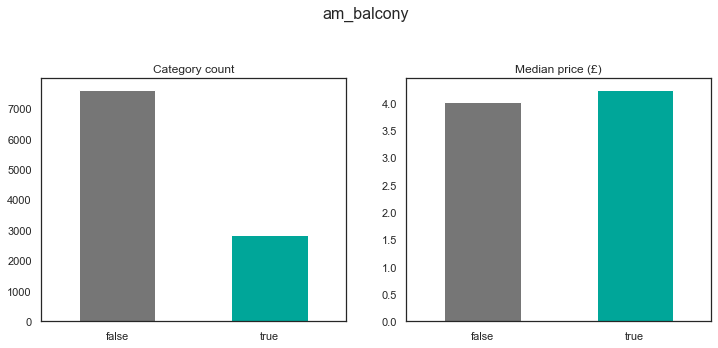

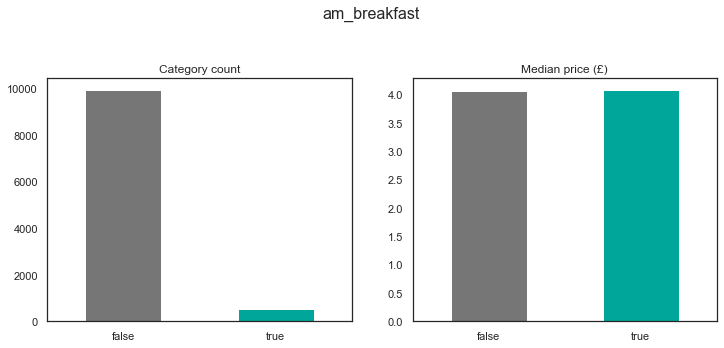

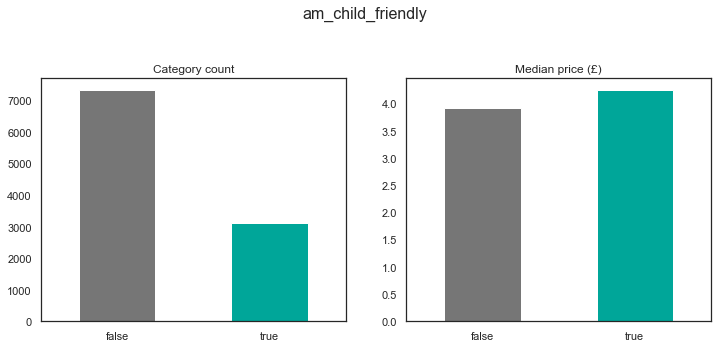

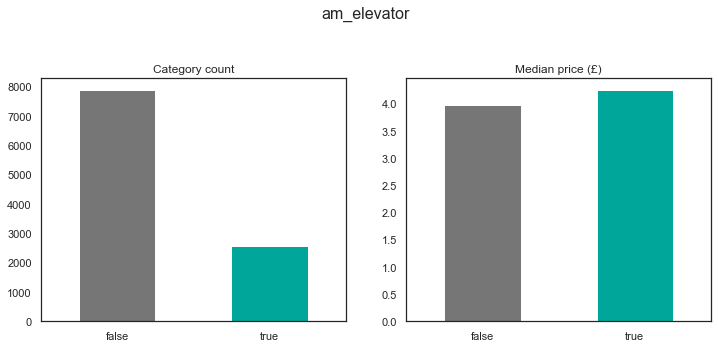

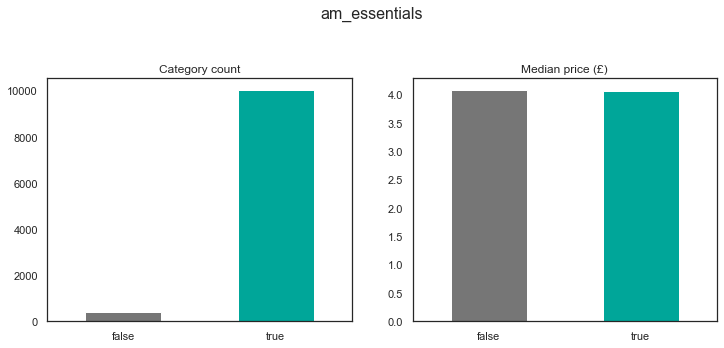

...

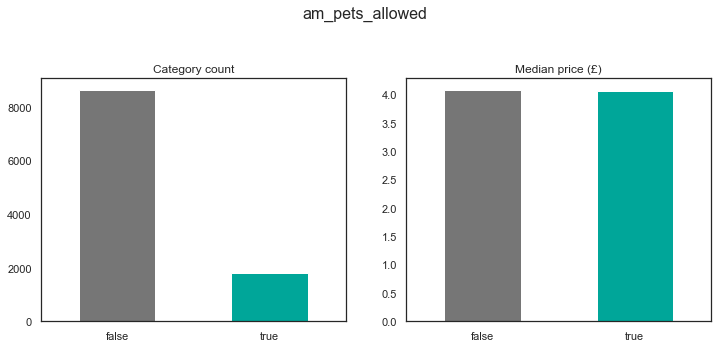

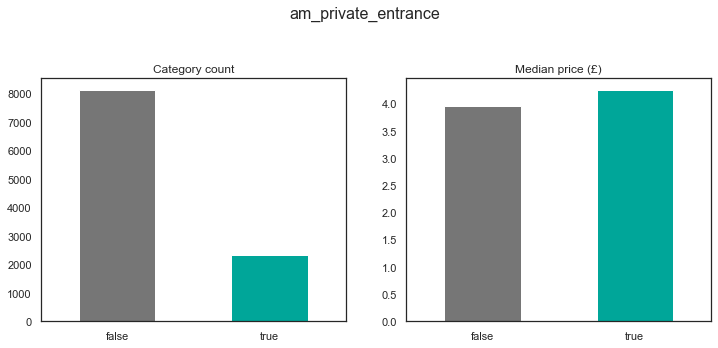

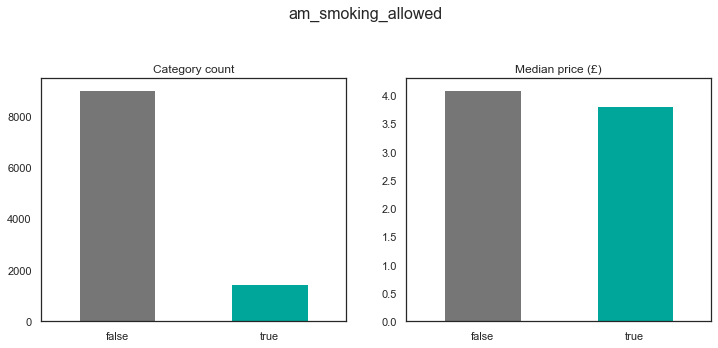

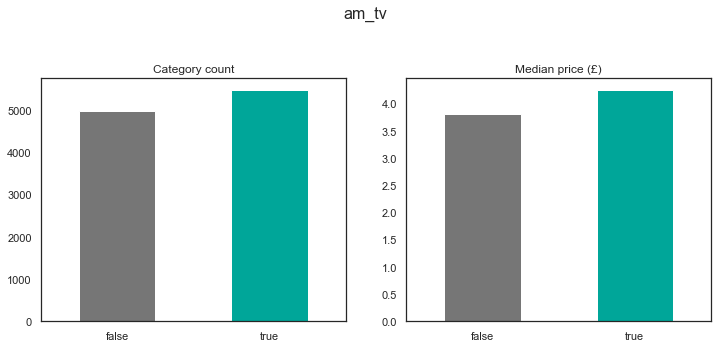

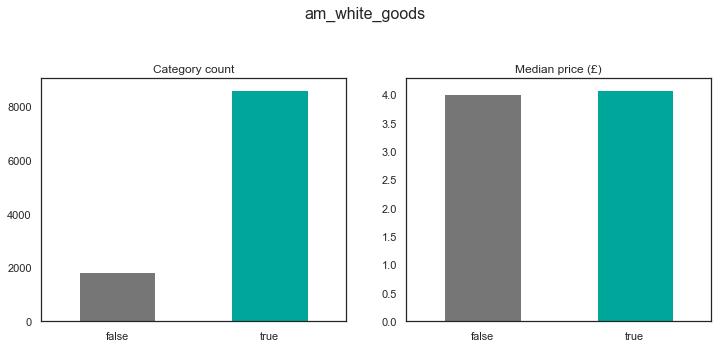

In [20]:
# Count and median price for amenities
am_col = [el for el in data.columns if el.startswith("am_")]

for col in am_col:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(
        top=0.80
    )  # So that the suptitle does not overlap with the ax plot titles

    data.groupby(col).size().plot(kind='bar',
                                  ax=ax1,
                                  color=["#767676", "#00A699"])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')

    data.groupby(col).price_log.median().plot(kind='bar',
                                              ax=ax2,
                                              color=["#767676", "#00A699"])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (£)')
    ax2.set_xlabel('')

    plt.show()

Measured against price_log, the differences among amenities are visually not as clear as in 2_EDA_Clean against price, but still show the same tendencies.

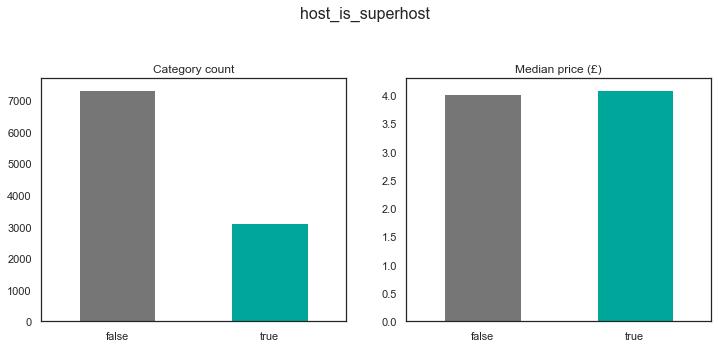

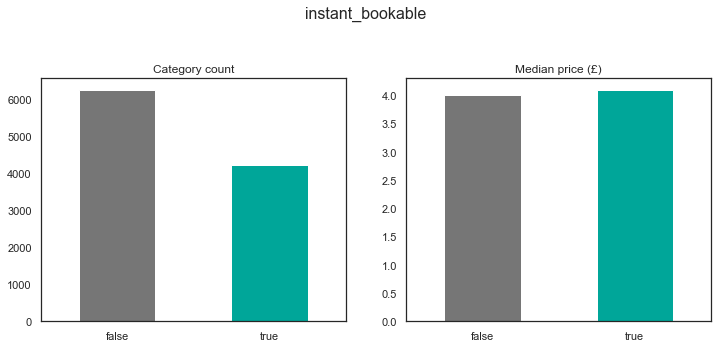

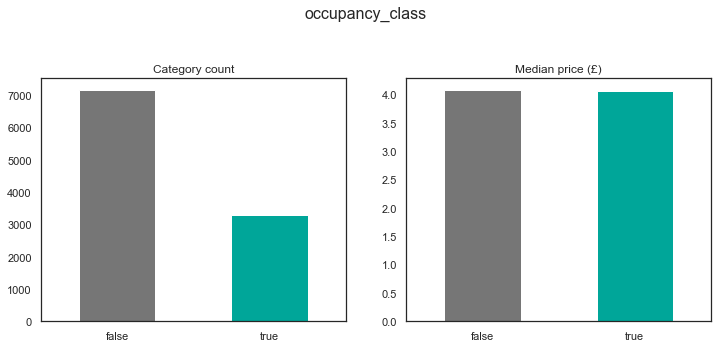

In [21]:
# Count and median price for binary columns
bin_col = ["host_is_superhost", "instant_bookable", "occupancy_class"]

for col in bin_col:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(
        top=0.80
    )  # So that the suptitle does not overlap with the ax plot titles

    data.groupby(col).size().plot(kind='bar',
                                  ax=ax1,
                                  color=["#767676", "#00A699"])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')

    data.groupby(col).price_log.median().plot(kind='bar',
                                              ax=ax2,
                                              color=["#767676", "#00A699"])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (£)')
    ax2.set_xlabel('')

    plt.show()

Superhost and instant bookability appear to have a slightly positive relationship, while occupancy class - with its limitations laid out under 3_Feature_Engineering - does not show an impact on median price.

C:\Users\Mauricio\anaconda3\envs\airbnb42\lib\site-packages\pandas\plotting\_tools.py:307: MatplotlibDeprecationWarning:


The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.

C:\Users\Mauricio\anaconda3\envs\airbnb42\lib\site-packages\pandas\plotting\_tools.py:307: MatplotlibDeprecationWarning:


The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.

C:\Users\Mauricio\anaconda3\envs\airbnb42\lib\site-packages\pandas\plotting\_tools.py:313: MatplotlibDeprecationWarning:


The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.

C:\Users\Mauricio\anaconda3\envs\airbnb42\lib\site-packages\pandas\plotting\_tools.py:313: MatplotlibDeprecationWarning:


The colNum attribute was deprecated in Matplotlib 3.2 and wil

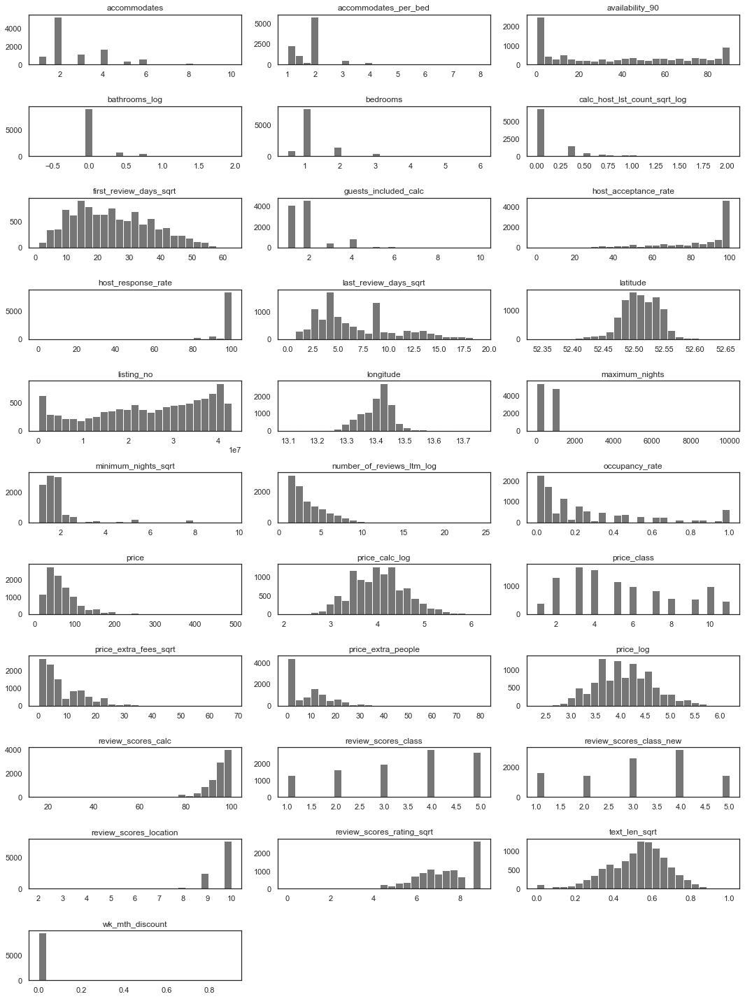

In [22]:
# Histogram of numerical features except amenities
hist_col = [el for el in num_features if el not in am_col]
hist_col = [el for el in hist_col if el not in bin_col]

data[hist_col].hist(figsize=(15, 20),
                    bins=25,
                    layout=(int(len(hist_col) / 3) + 1, 3),
                    grid=False)
plt.tight_layout()
savefig(title="histogram_num_features", library="plt")

Many features appear more balanced after transformation to log and/or sqrt.

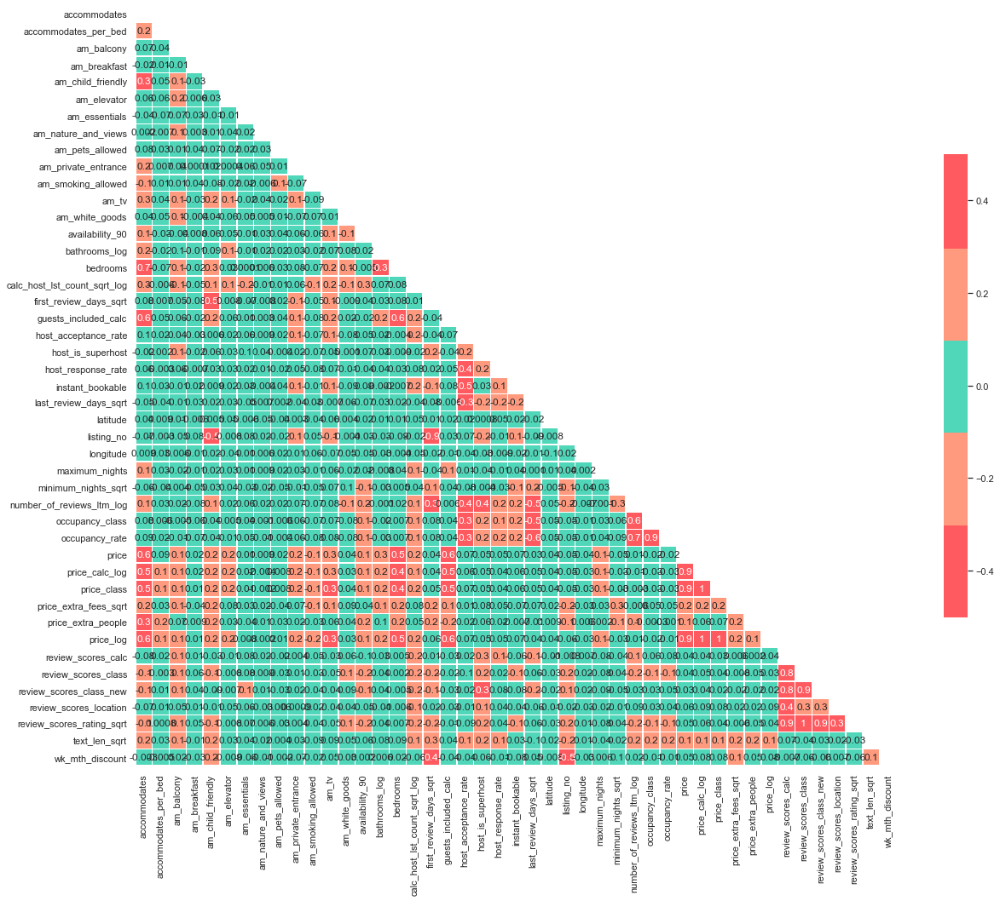

In [23]:
# Correlation heatmap for numerical features (Version 1)
#Generate a mask for the upper triangle
mask = np.triu(np.ones_like(data[num_features].corr(), dtype=np.bool))

#Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

#Generate a custom diverging colormap
#cmap = sns.diverging_palette(220, 10, as_cmap=True)
#cmap = [(0, 166, 153), (255, 90, 95)]

#Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(data[num_features].corr(),
            mask=mask,
            cmap=["#FF5A5F", "#FF9A7F", "#50D6B9", "#FF9A7F", "#FF5A5F"],
            vmax=.5,
            vmin=-.5,
            center=0,
            square=True,
            linewidths=.5,
            cbar_kws={"shrink": .5},
            annot=True,
            fmt=".1g")

savefig(title="full_heatmap", library="plt")

The strongest remaining correlating features are dropped at the beginning of 5_Predictive_Modeling.

In [24]:
# Scatterplot y=price_log x=calculated_host_listings_count
data.host_is_superhost = data.host_is_superhost.astype(str)
fig = px.scatter(data,
                 x='accommodates',
                 y='price_log',
                 title='Price vs. Accommodates',
                 color='host_is_superhost',
                 color_continuous_scale=None,
                 marginal_y='violin',
                 marginal_x='box',
                 trendline='ols',
                 opacity=0.3)
fig.show()
savefig(fig, title="scatter_price_vs_accommodates")
data.host_is_superhost = data.host_is_superhost.astype(int)

Superhosts achieve a higher price on average, even though this relationship does not appear to be particularly strong.

In [25]:
# Histogram matrix price class vs. room type vs. occupancy
fig = px.histogram(
    data,
    x='price_class',
    title='Price Class by Room Type',
    color='host_is_superhost',
    barmode='relative',  # 'group', 'overlay', 'relative'
    facet_row='occupancy_class',
    facet_col='room_type',
)
fig.show()
savefig(fig, title="facet_price_vs_room_type")

It is clearly observable that entire home/apt is more equally distributed across all price classes, while private rooms are in the lower half. Even though shared room and hotel room do not account for many listings, it is still recognizable that the former are in the lower price classes, the latter in the higher range.

In [26]:
# Scatter Matrix of select features
fig = px.scatter_matrix(data,
                        dimensions=[
                            "accommodates", "calc_host_lst_count_sqrt_log",
                            "price_log", "review_scores_rating_sqrt"
                        ],
                        title="Scatter Matrix",
                        color='room_type',
                        opacity=0.5,
                        width=1000,
                        height=1000)
fig.show()
savefig(fig, title="matrix_key_features")

In [27]:
# Parallel Categories for select features
fig = px.parallel_categories(data,
                             title="Parallel Categories",
                             dimensions=[
                                 "room_type", "price_class",
                                 "review_scores_class", "occupancy_class"
                             ],
                             color='host_is_superhost')

fig.show()
savefig(fig, title="parcat_occupancy_class")

**Review Scores**

In [58]:
# Plot histogram of review_scores_class
fig = px.histogram(
    data,
    x="review_scores_class",
    color="host_is_superhost",
    title="Review Scores Histogram",
    #             marginal="rug",
    nbins=50)

fig.show()
savefig(fig, title="histogram_review_scores")

Class "5" for review scores equals a perfect score of 100%. Consequently, the plot indicates:
- Unsurprisingly, the amount of superhosts correlates with review scores, at least up until class "5"
- The lower amount of superhosts among class "5" indicates that these listings may have received less reviews so far, hence achieving 100% with few ratings (to be verified in sequence)

In [29]:
# Boxplot review_scores_class vs. first_review_days_sqrt
fig = px.box(data,
             x="review_scores_class",
             y="first_review_days_sqrt",
             title='Review Scores vs. Days since First Review',
             color="host_is_superhost",
             points="outliers")
fig.show()
savefig(fig, title="box_review_scores_vs_first_review_days")

This plot seems to confirm that listings with perfect scores tend to be newer - particularly those which are not listed by a superhost. This should be considered for predictive modeling as it might distort the results. Hence, a new feature is created, penalizing a) new listings and b) listings with few reviews in the last twelve months (see below)

In [57]:
# Plot histogram of review_scores_class_new
fig = px.histogram(
    data,
    x="review_scores_class_new",
    color="host_is_superhost",
    title="Review Scores Histogram",
    #             marginal="rug",
    nbins=50)

fig.show()
savefig(fig, title="histogram_review_scores2")

In [31]:
# Boxplot review_scores_class_new vs. first_review_days_sqrt
fig = px.box(data,
             x="review_scores_class_new",
             y="first_review_days_sqrt",
             title='Review Scores vs. Days since First Review',
             color="host_is_superhost",
             points="outliers")
fig.show()
#savefig(fig, title="box_review_scores_vs_first_review_days")

The impact is clearly visible when measuring the share of superhosts. However, the impact on price is marginal at best (see below) and - even when adapting the penalization - unfortunately did not yield any improvements to the predictive models.

In [32]:
# Stripplot price_log vs review_scores_class
fig = px.strip(data,
               x="price_log",
               y="review_scores_class",
               title="Price vs. Review Scores Class",
               orientation="h",
               color="occupancy_class")
fig.show()

In [33]:
# Stripplot price_log vs review_scores_class_new
fig = px.strip(data,
               x="price_log",
               y="review_scores_class_new",
               title="Price vs. Review Scores Class New",
               orientation="h",
               color="occupancy_class")
fig.show()

**Cancellation Policy**

In [34]:
# Value Count for Cancellation Policies
data.cancellation_policy.value_counts()

strict          4329
moderate        3522
flexible        2510
super_strict      88
Name: cancellation_policy, dtype: int64

In [35]:
# Boxplot review_scores_class_new vs. first_review_days_sqrt
fig = px.box(data,
             x="cancellation_policy",
             y="price_log",
             title='Price per Cancellation Policy',
             color="host_is_superhost",
             points="outliers")
fig.show()
#savefig(fig, title="box_price_per_cancellation_policy")

Hosts with higher prices appear to apply a stricter cancellation policy. Super_strict is neglected as it accounts for less than 100 listings.

**Host Response Time**

In [36]:
# Boxplot reviews vs. host_response_time
fig = px.box(data,
             y="number_of_reviews_ltm_log",
             x="host_response_time",
             title="Price vs. Host Response Time",
             color="host_is_superhost",
             points="outliers")
fig.show()
savefig(fig, title="box_reviews_vs_host_response_time")

A fast host_response_time appears to be strongly linked with a high number of reviews in the last year as well as holding superhost status.

**Accommodates**

In [37]:
# Boxplot price_log vs. accommodates
fig = px.box(data,
             y="price_log",
             x="accommodates",
             title="Price vs. Accommodates",
             color="host_is_superhost",
             points="outliers")
fig.show()
savefig(fig, title="box_price_vs_accommodates")

In [38]:
# Violinplot price_log vs. accommodates
fig = px.violin(data,
                y="price_log",
                x="accommodates",
                title="Price vs. Accommodates",
                color="host_is_superhost",
                box=True,
                points="all")
fig.show()
savefig(fig, title="violin_price_vs_accommodates")

Prices steadily increase with higher number of "accommodates", even though the highest values for "accommodates" are less interpretable as they cover substantially fewer listings.

**Host Listings**

In [39]:
# Violinplot price_log vs. calc_host_lst_count_sqrt_log
fig = px.violin(
    data,
    y="calc_host_lst_count_sqrt_log",
    x="price_class",
    title="Price vs. Host Listings",
    color="host_is_superhost",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_host_listings")

**Cancellation Policy**

In [40]:
# Violinplot price_log vs. cancellation_policy
fig = px.violin(
    data,
    y="price_log",
    x="cancellation_policy",
    title="Price vs. Cancellation Policy",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_cancellation_policy")

As observed previously, hosts with higher prices appear to select a stricter cancellation policy.

In [41]:
# Violinplot price_log vs. wk_mth_discount
fig = px.violin(
    data,
    y="wk_mth_discount",
    x="price_class",
    title="Price vs. Discount",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_discount")

In [42]:
# Violinplot price_log vs. text_len_sqrt
fig = px.violin(
    data,
    y="calc_host_lst_count_sqrt_log",
    x="price_class",
    title="Host Listings vs. Price Class",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_host_listings_vs_price_class")

In [43]:
# Boxplot price_log vs room_type
fig = px.box(data,
               x="room_type",
               y="price_log",
               title="Price vs. Room Type",
               color="host_is_superhost")
fig.show()
savefig(fig, title="box_price_vs_roomtype")

In [44]:
# Boxplot price_log vs property_type
fig = px.box(data,
               x="property_type",
               y="price_log",
               title="Price vs. Property Type",
               color="host_is_superhost")
fig.show()
savefig(fig, title="box_price_vs_propertytype")

In [45]:
# Boxplot price_log vs zipcode
fig = px.area(data.groupby("zipcode").price.median().sort_values(),
               x=data.groupby("zipcode").price.median().sort_values().index,
               y="price",
               title="Price vs. Zipcode")
fig.show()
savefig(fig, title="area_price_vs_zipcode")

## Map visualizations (graphical exploration)

In [55]:
# Prepare geojson and data_geo

# Load up the file
geojson = gpd.read_file(f'data/{dataset_loc}_{dataset_date}/neighbourhoods.geojson')

# Creating a dataframe of listing counts and median price by borough
data_geo = pd.DataFrame(data.groupby('neighbourhood_cleansed').size())
data_geo.rename(columns={0: 'number_of_listings'}, inplace=True)
data_geo['median_price_log'] = data.groupby(
    'neighbourhood_cleansed').price_log.median().values

# Calculate price
data["price"] = [round(curr.convert(math.exp(el), 'USD', 'EUR', date=date(2020, 3, 17))) for el in data.price_log]
data_geo['median_price'] = data.groupby(
    'neighbourhood_cleansed').price.median().values

# Joining the dataframes
#data_geo_map = geojson.set_index('neighbourhood').join(data_geo)
data_geo["neighbourhood"] = data_geo.index

In [52]:
# Berlin map with all listings (color = price; size = accommodates)
fig = px.scatter_mapbox(
    data,
    title="Berlin | All Listings",
    lat="latitude",
    lon="longitude",
    color="price_log",
    size="accommodates",
    size_max=15,
    hover_name="listing_no",
    hover_data={
        "latitude": False,
        "longitude": False,
        "price_log": False,
        "bedrooms": True,
        "price": True,
        "room_type": True,
        "neighbourhood_cleansed": False,
        "occupancy_rate": True,
        "occupancy_rate": ":.2f"
    },
    #    range_color=[10,200],
    zoom=9,
    opacity=0.8,
    mapbox_style="carto-positron")

fig.show()
savefig(fig, title="Berlin_map_all_listings")

Retrieve a listing by adding its number to https://www.airbnb.com/rooms/ in the address bar
(example: https://www.airbnb.com/rooms/40610629 )

In [48]:
# Berlin map with listings per "neighbourhood_cleansed"
fig = px.choropleth_mapbox(data_geo,
                           title="Berlin | Listings per Neighbourhood",
                           geojson=geojson,
                           color="number_of_listings",
                           locations="neighbourhood",
                           featureidkey="properties.neighbourhood",
                           center={
                               "lat": 52.5200,
                               "lon": 13.4050
                           },
                           hover_name="neighbourhood",
                           hover_data={
                               "number_of_listings": True,
                               "median_price": ":.2f",
                               "median_price_log": False,
                               "neighbourhood": False
                           },
                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5)
fig.show()
savefig(fig, title="Berlin_map_listings_per_neighbh")

In [56]:
# Berlin map with prices per "neighbourhood_cleansed"
fig = px.choropleth_mapbox(data_geo,
                           title="Berlin | Avg Prices per Neighbourhood",
                           geojson=geojson,
                           color="median_price",
                           locations="neighbourhood",
                           featureidkey="properties.neighbourhood",
                           center={
                               "lat": 52.5200,
                               "lon": 13.4050
                           },
                           hover_name="neighbourhood",
                           hover_data={
                               "number_of_listings": True,
                               "median_price": ":.2f",
                               "median_price_log": False,
                               "neighbourhood": False
                           },
                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5)
fig.show()
savefig(fig, title="Berlin_map_price_per_neighbh")